In [1]:
%load_ext autoreload
%autoreload 2
import pandas as pd
import numpy as np
import matplotlib
import telecontrol_parser as tp
import timeseries_functions as tf
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import modelling as mdl
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.linear_model import *
from sklearn.neural_network import *
from sklearn.ensemble import *
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn import tree
import sklearn
from sklearn.experimental import enable_hist_gradient_boosting
import tkinter
import plotly
import statsmodels.api as sma
from importlib import reload
import tensorflow
import keras

root = tkinter.Tk()
my_dpi = root.winfo_fpixels('1i')

In [2]:
MLdb = mdl.MLdata('../data_sets/feats/')
MLdb.load_datasets()
MLdb.set_dataset(2,features=('lobith_feats','gemaal_feats','knmi_feats','waterstanden_feats'))
# MLdb.set_dataset(2,features=tuple())


In [3]:

# MLdb.combine_datasets()
# print(MLdb.datadict[list(MLdb.datadict.keys())[2]])
# print(MLdb.datadict['ALL'])
# print(MLdb.get_datasets())
print(len(MLdb.dataset.columns))
MLdb.clean_columns()
print(len(MLdb.dataset.columns))
MLdb.drop_na()
print(len(MLdb.dataset.columns))
MLdb.create_train_test_split(0.8)

# MLdb.linear_regression()
MLdb.scale_data(mode = 'y',scaler = 'minmax')
y_pred_naive = MLdb.naive_predictive()
# MLdb.dataset
# MLdb.vif_threshold = 20

852
847
847


In [4]:
# reshape input to be [samples, time steps, features]
# trainX = np.reshape(np.array(MLdb.train_x), (MLdb.train_x.shape[0], 1, MLdb.train_x.shape[1]))
# testX = np.reshape(np.array(MLdb.test_x), (MLdb.test_x.shape[0], 1, MLdb.test_x.shape[1]))


In [5]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import math

<AxesSubplot:>

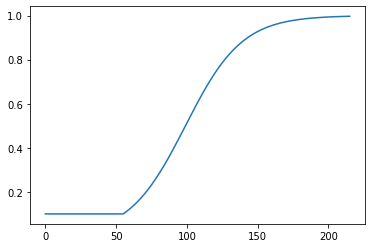

In [6]:
bereik = MLdb.train_y.shape[1]+1
xrange = (list(range(1,bereik)))
exp = 8
offset = 6*2
k = 0.05
# weights = list(map(lambda x : min(1.0,max(0.1,(x+offset)**exp/(bereik-1)**exp)),xrange))
weights = list(map(lambda x : max(0.1,(bereik/(1+(math.e**(-k*(x-100))))/bereik)),xrange))
pd.Series(weights).plot()

In [7]:


path_checkpoint = "model_checkpoint.h5"
es_callback = keras.callbacks.EarlyStopping(monitor="val_loss", min_delta=0, patience=3)

modelckpt_callback = keras.callbacks.ModelCheckpoint(
    monitor="val_loss",
    filepath=path_checkpoint,
    verbose=1,
    save_weights_only=True,
    save_best_only=True,
)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 631)               398792    
_________________________________________________________________
dense_1 (Dense)              (None, 631)               398792    
_________________________________________________________________
dense_2 (Dense)              (None, 631)               398792    
_________________________________________________________________
dense_3 (Dense)              (None, 631)               398792    
_________________________________________________________________
dense_4 (Dense)              (None, 631)               398792    
_________________________________________________________________
dense_5 (Dense)              (None, 631)               398792    
_________________________________________________________________
dense_6 (Dense)              (None, 631)               3

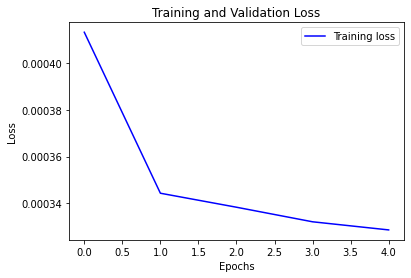

In [8]:
look_back = 1
trainY = np.array(MLdb.train_y)
# create and fit the LSTM network
model = Sequential()
model.add(Dense(MLdb.train_x.shape[1],input_shape=(MLdb.train_x.shape[1],)))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))
model.add(Dense(MLdb.train_x.shape[1]))

model.add(Dense(216))
model.compile(loss=tensorflow.keras.losses.MeanSquaredError(), 
    optimizer=tensorflow.keras.optimizers.Adam(
        learning_rate= 0.0001),
    loss_weights = weights
    )
# model.build(input_shape = (1,1,12))
model.summary()
history = model.fit(MLdb.train_x, MLdb.train_y_scaled, 
    epochs=5, 
    batch_size=64, 
    verbose=2,
    # validation_data=(MLdb.test_x,np.array(MLdb.test_y_scaled)),
    callbacks=[es_callback, modelckpt_callback]
    )
def visualize_loss(history, title):
    loss = history.history["loss"]
    # val_loss = history.history["val_loss"]
    epochs = range(len(loss))
    plt.figure()
    plt.plot(epochs, loss, "b", label="Training loss")
    # plt.plot(epochs, val_loss, "r", label="Validation loss")
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

visualize_loss(history, "Training and Validation Loss")

In [9]:
y_pred_train = pd.DataFrame(model.predict(MLdb.train_x))
y_pred = pd.DataFrame(model.predict(MLdb.test_x))

In [10]:
y_pred_unscaled =  pd.DataFrame(MLdb.scaler_y.inverse_transform(y_pred))
y_pred_train_unscaled =  pd.DataFrame(MLdb.scaler_y.inverse_transform(y_pred_train))

<Figure size 432x288 with 0 Axes>

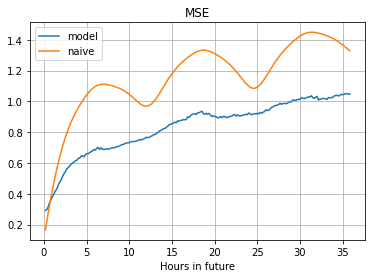

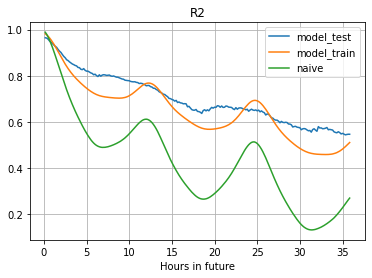

<Figure size 432x288 with 0 Axes>

In [11]:
mape_list = []
R2_list = []
R2_train_list = []
mape_list_naive = []
R2_list_naive = []

# y_pred_train = model.predict(MLdb.train_x)
# y_pred_train = pd.DataFrame(model.predict(np.reshape(np.array(MLdb.train_x),(MLdb.train_x.shape[0],1,MLdb.train_x.shape[1]))))
# y_pred_train = pd.DataFrame(MLdb.scaler.inverse_transform(pd.DataFrame(model.predict(train_data_gen))))


for i in range(0,MLdb.test_y.shape[1]-1):
    # test_y = MLdb.test_y.iloc[:,i].values
    # train_y = MLdb.train_y.iloc[:,i].values
    # pred_y = y_pred.iloc[:,i]
    # pred_y_train = y_pred_train.iloc[:,1]
    # pred_y_naive = y_pred_naive.iloc[:,i]
    test_y = MLdb.test_y.iloc[:,i].values
    train_y = MLdb.train_y.iloc[:,i].values
    pred_y = y_pred_unscaled.iloc[:,i]
    pred_y_train = y_pred_train_unscaled.iloc[:,1]
    pred_y_naive = y_pred_naive.iloc[:,i]
    
    mape_list.append(mse(test_y,pred_y)**(1/2))
    R2_list.append(r2_score(test_y,pred_y))
    mape_list_naive.append(mse(test_y,pred_y_naive)**(1/2))
    R2_list_naive.append(r2_score(test_y,pred_y_naive))
    R2_train_list.append(r2_score(train_y,pred_y_train))

R2_list = np.array(R2_list).clip(min=0)


x_bereik = [(i*10+10)/60 for i in range(len(R2_list))]
plt.plot(x_bereik,mape_list,label = 'model')
plt.plot(x_bereik,mape_list_naive,label = 'naive')
plt.title('MSE')
plt.xlabel('Hours in future')
plt.legend()
plt.grid()
plt.figure()
plt.plot(x_bereik,R2_list,label = 'model_test')
plt.plot(x_bereik,R2_train_list,label ='model_train')
plt.plot(x_bereik,R2_list_naive, label = 'naive')
plt.title('R2')
plt.xlabel('Hours in future')
plt.legend()
plt.grid()
plt.figure()


In [13]:
model.save('NN.h5')
MLdb.model = model
MLdb.create_predictions()


In [14]:
MLdb.predict_window2(MLdb.get_random_date())

,EGV_OPP,ypred
datetime,,
2021-03-25 15:40:00,1.330,NaN
2021-03-25 15:50:00,1.202,NaN
2021-03-25 16:00:00,1.419,NaN
2021-03-25 16:10:00,1.256,NaN
2021-03-25 16:20:00,1.447,NaN
...,...,...
2021-03-29 03:00:00,1.156,0.791412
2021-03-29 03:10:00,1.153,0.777552
2021-03-29 03:20:00,1.149,0.744298


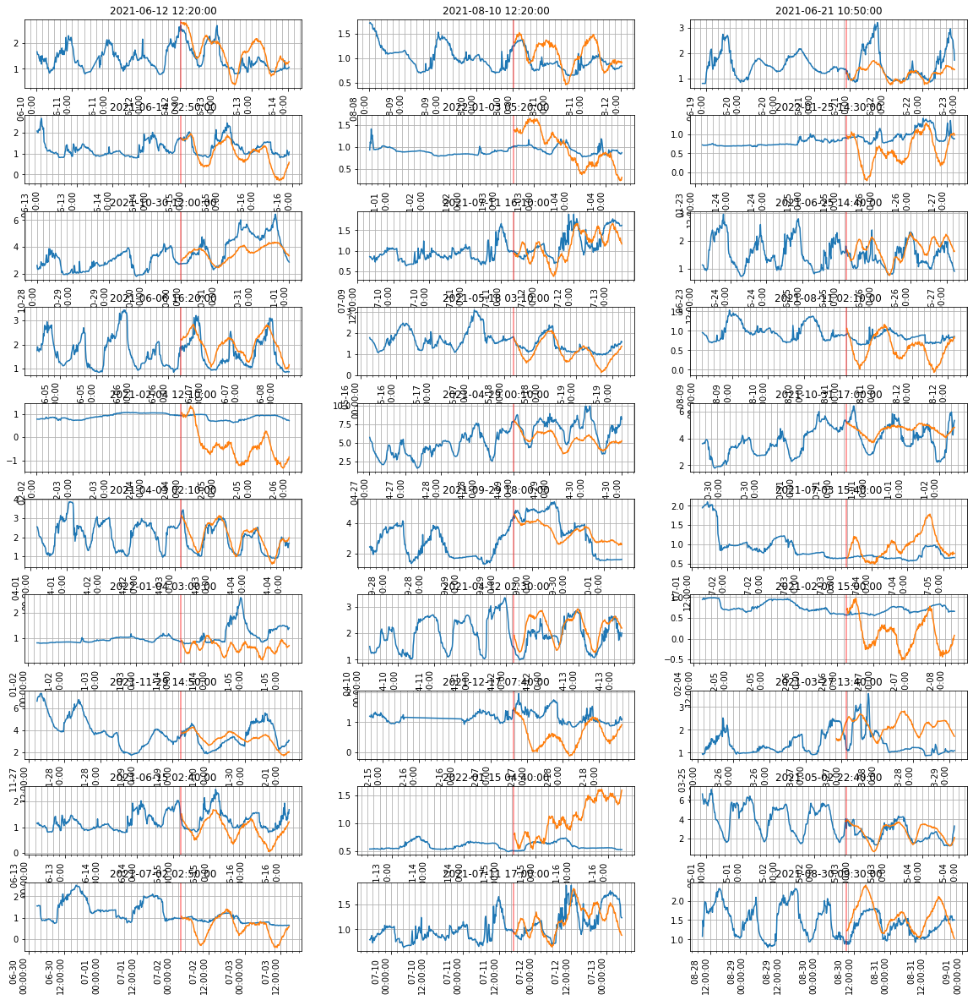

In [15]:
rows = 10
cols = 3
yscale = 1
xscale = 2

fig, ax = plt.subplots(nrows=rows, ncols=cols,figsize=(yscale*1920/my_dpi, xscale*1080/my_dpi))

for row in range(rows):
    for col in range(cols):
        startdate = MLdb.get_random_date('test')
        comp = MLdb.predict_window2(past = 2,startdate = startdate)
        plot = comp.plot(ax = ax[row,col], legend = False,x_compat = True)

        plot.set(xlabel=None)
        # plot.xaxis.get_ticklocs(minor=True)
        plot.set_title(str(startdate))
        # plot.minorticks_on()
        plot.xaxis.set_minor_locator(ticker.AutoMinorLocator(6))
        plot.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%m-%d \n%H:%M:%S'))


        plot.tick_params(axis='x',labelsize = 10,labelrotation= 90)
        plot.grid(which = 'both')
        plot.axvline(startdate,color = 'red',alpha = 0.5)

plt.subplots_adjust(hspace=0.4)
plt.show()


2021-04-06 14:40:00
2021-04-06 14:50:00
2021-04-06 15:00:00
2021-04-06 15:10:00
2021-04-06 15:20:00
2021-04-06 15:30:00
2021-04-06 15:40:00
2021-04-06 15:50:00
2021-04-06 16:00:00
2021-04-06 16:10:00
2021-04-06 16:20:00
2021-04-06 16:30:00
2021-04-06 16:40:00
2021-04-06 16:50:00
2021-04-06 17:00:00
2021-04-06 17:10:00
2021-04-06 17:20:00
2021-04-06 17:30:00
2021-04-06 17:40:00
2021-04-06 17:50:00
2021-04-06 18:00:00
2021-04-06 18:10:00
2021-04-06 18:20:00
2021-04-06 18:30:00
2021-04-06 18:40:00
2021-04-06 18:50:00
2021-04-06 19:00:00
2021-04-06 19:10:00
2021-04-06 19:20:00
2021-04-06 19:30:00
2021-04-06 19:40:00
2021-04-06 19:50:00
2021-04-06 20:00:00
2021-04-06 20:10:00
2021-04-06 20:20:00
2021-04-06 20:30:00
2021-04-06 20:40:00
2021-04-06 20:50:00
2021-04-06 21:00:00
2021-04-06 21:10:00
2021-04-06 21:20:00
2021-04-06 21:30:00
2021-04-06 21:40:00
2021-04-06 21:50:00
2021-04-06 22:00:00
2021-04-06 22:10:00
2021-04-06 22:20:00
2021-04-06 22:30:00
2021-04-06 22:40:00
2021-04-06 22:50:00


<AxesSubplot:xlabel='datetime'>

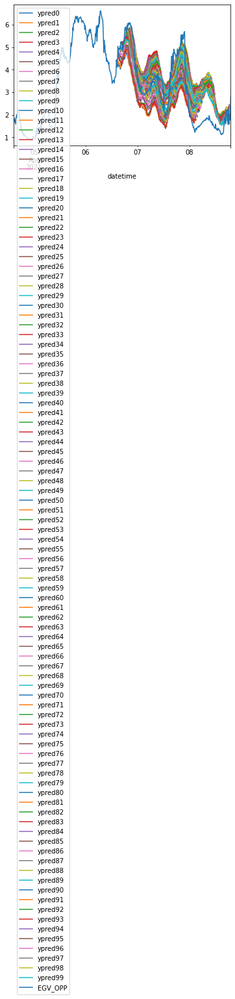

In [16]:
MLdb.simulate_live(100).plot()

In [17]:
import shap

c:\Users\Admin\Anaconda3\envs\py36_env\lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [18]:
explainer = shap.KernelExplainer(MLdb.model, shap.sample(MLdb.train_x,1000))

Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [29]:
X_idx = 0
shap_values = explainer.shap_values(X = MLdb.train_x.iloc[X_idx:X_idx+10,:],nsamples=100)

# X_train = MLdb.train_x
# background = X_train.iloc[np.random.choice(X_train.shape[0], 100, replace=False)]

# explainer = shap.DeepExplainer(
#     (model.layers[0].input, model.layers[-1].output), background
# )

  0%|          | 0/10 [00:00<?, ?it/s]Regressors in active set degenerate. Dropping a regressor, after 1 iterations, i.e. alpha=5.155e-03, with an active set of 1 regressors, and the smallest cholesky pivot element being 1.490e-08. Reduce max_iter or increase eps parameters.
Regressors in active set degenerate. Dropping a regressor, after 4 iterations, i.e. alpha=4.125e-03, with an active set of 4 regressors, and the smallest cholesky pivot element being 1.490e-08. Reduce max_iter or increase eps parameters.
Regressors in active set degenerate. Dropping a regressor, after 10 iterations, i.e. alpha=2.577e-03, with an active set of 8 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
Regressors in active set degenerate. Dropping a regressor, after 10 iterations, i.e. alpha=2.577e-03, with an active set of 8 regressors, and the smallest cholesky pivot element being 1.490e-08. Reduce max_iter or increase eps parameters.
Regresso

In [32]:
shap_values[0].shape

(10, 631)

In [21]:
# shap.summary_plot(shap_values,MLdb.train_x,feature_names=MLdb.train_x.columns)

In [22]:
shap.initjs()
i= 200
shap.force_plot(explainer.expected_value[i], shap_values[i],feature_names=MLdb.train_x.columns)


Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 


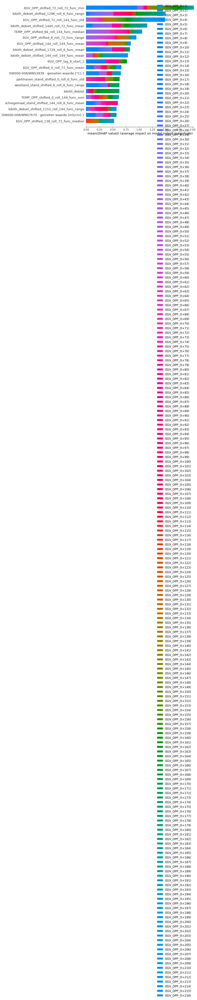

In [23]:
shap.summary_plot(shap_values,MLdb.train_x,feature_names = MLdb.train_x.columns,class_names=MLdb.train_y.columns,class_inds=list(range(216)))

In [24]:
# shap.waterfall_plot(explainer.expected_value,shap_values)

In [28]:
shap.plots.force(0,np.array([i.flatten() for i in shap_values]),feature_names=MLdb.train_y.columns)

In [37]:
for ele in range(10):
   if ele==9:
    shap.plots.force(0,np.array([i[ele] for i in shap_values]),feature_names=MLdb.train_y.columns)


In [46]:
np.array([i[5] for i in shap_values]).shape

(216, 631)

In [89]:
shap.plots.force(explainer.expected_value[0],np.array([i[0] for i in shap_values]),feature_names=MLdb.train_x.columns,figsize=(20, 9))

In [87]:
shap.plots.force(explainer.expected_value[0],np.array([i[9] for i in shap_values]),feature_names=MLdb.train_x.columns,figsize=(20, 9))

In [85]:
explainer.expected_value[0]

0.15352986958995463

In [57]:
comp = MLdb.predict_window2(startdate = MLdb.train_x.index[9])
plot = comp.plot(ax = ax[row,col], legend = False,x_compat = True)

plot.set(xlabel=None)
# plot.xaxis.get_ticklocs(minor=True)
plot.set_title(str(startdate))
# plot.minorticks_on()
plot.xaxis.set_minor_locator(ticker.AutoMinorLocator(6))
plot.xaxis.set_major_formatter(matplotlib.dates.DateFormatter('%m-%d \n%H:%M:%S'))


plot.tick_params(axis='x',labelsize = 10,labelrotation= 90)
plot.grid(which = 'both')
plot.axvline(startdate,color = 'red',alpha = 0.5)
plt.show()

<AxesSubplot:>

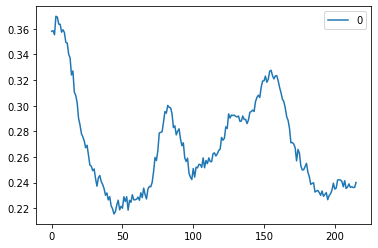

In [82]:
pd.DataFrame(MLdb.scaler_y.transform(pd.DataFrame(comp['ypred'].T[1:]).T)[0]).plot()